# Hate Crime Data Analysis

In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from plotly.offline import download_plotlyjs,init_notebook_mode,plot,iplot
import plotly.express as px
init_notebook_mode(connected = True)
import warnings
warnings.filterwarnings('ignore')

from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from wordcloud import WordCloud, STOPWORDS

### loading the dataset

In [2]:
hate_crime = pd.read_csv('hate_crime.csv')
hate_crime.head()

,incident_id,data_year,ori,pug_agency_name,pub_agency_unit,agency_type_name,state_abbr,state_name,division_name,region_name,...,offender_race,offender_ethnicity,victim_count,offense_name,total_individual_victims,location_name,bias_desc,victim_types,multiple_offense,multiple_bias
0,43,1991,AR0350100,Pine Bluff,NaN,City,AR,Arkansas,West South Central,South,...,Black or African American,Not Specified,1,Aggravated Assault,1.0,Residence/Home,Anti-Black or African American,Individual,S,S
1,44,1991,AR0350100,Pine Bluff,NaN,City,AR,Arkansas,West South Central,South,...,Black or African American,Not Specified,2,Aggravated Assault;Destruction/Damage/Vandalis...,1.0,Highway/Road/Alley/Street/Sidewalk,Anti-White,Individual,M,S
2,45,1991,AR0600300,North Little Rock,NaN,City,AR,Arkansas,West South Central,South,...,Black or African American,Not Specified,2,Aggravated Assault;Murder and Nonnegligent Man...,2.0,Residence/Home,Anti-White,Individual,M,S
3,46,1991,AR0600300,North Little Rock,NaN,City,AR,Arkansas,West South Central,South,...,Black or African American,Not Specified,1,Intimidation,1.0,Residence/Home,Anti-White,Individual,S,S
4,47,1991,AR0670000,Sevier,NaN,County,AR,Arkansas,West South Central,South,...,White,Not Specified,1,Intimidation,1.0,School/College,Anti-Black or African American,Individual,S,S


In [3]:
hate_crime[['incident_id','incident_date','data_year','state_abbr','state_name','offense_name','bias_desc','victim_types','multiple_offense']].head()

,incident_id,incident_date,data_year,state_abbr,state_name,offense_name,bias_desc,victim_types,multiple_offense
0,43,1991-07-04,1991,AR,Arkansas,Aggravated Assault,Anti-Black or African American,Individual,S
1,44,1991-12-24,1991,AR,Arkansas,Aggravated Assault;Destruction/Damage/Vandalis...,Anti-White,Individual,M
2,45,1991-07-10,1991,AR,Arkansas,Aggravated Assault;Murder and Nonnegligent Man...,Anti-White,Individual,M
3,46,1991-10-06,1991,AR,Arkansas,Intimidation,Anti-White,Individual,S
4,47,1991-10-14,1991,AR,Arkansas,Intimidation,Anti-Black or African American,Individual,S


### Data properties

In [4]:
hate_crime.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 226328 entries, 0 to 226327
Data columns (total 28 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   incident_id                   226328 non-null  int64  
 1   data_year                     226328 non-null  int64  
 2   ori                           226328 non-null  object 
 3   pug_agency_name               226328 non-null  object 
 4   pub_agency_unit               6563 non-null    object 
 5   agency_type_name              226328 non-null  object 
 6   state_abbr                    226328 non-null  object 
 7   state_name                    226328 non-null  object 
 8   division_name                 226328 non-null  object 
 9   region_name                   226328 non-null  object 
 10  population_group_code         225924 non-null  object 
 11  population_group_description  225924 non-null  object 
 12  incident_date                 226328 non-nul

In [4]:
hate_crime.describe(include='all')

,incident_id,data_year,ori,pug_agency_name,pub_agency_unit,agency_type_name,state_abbr,state_name,division_name,region_name,...,offender_race,offender_ethnicity,victim_count,offense_name,total_individual_victims,location_name,bias_desc,victim_types,multiple_offense,multiple_bias
count,2.263280e+05,226328.000000,226328,226328,6563,226328,226328,226328,226328,226328,...,226328,226328,226328.000000,226328,222849.000000,226328,226328,226328,226328,226328
unique,NaN,NaN,9988,6689,648,8,53,53,11,6,...,8,5,NaN,373,NaN,143,302,55,2,2
top,NaN,NaN,NY0303000,New York,Ann Arbor,City,CA,California,Pacific,West,...,Unknown,Not Specified,NaN,Destruction/Damage/Vandalism of Property,NaN,Residence/Home,Anti-Black or African American,Individual,S,S
freq,NaN,NaN,10717,10717,153,180702,36308,36308,50569,68736,...,93065,198194,NaN,68181,NaN,67255,76915,179377,218632,225129
mean,2.709189e+05,2005.943476,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,1.247592,NaN,0.984492,NaN,NaN,NaN,NaN,NaN
std,4.359237e+05,8.871649,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,2.243617,NaN,1.162006,NaN,NaN,NaN,NaN,NaN
min,2.000000e+00,1991.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,1.000000,NaN,0.000000,NaN,NaN,NaN,NaN,NaN
25%,5.661075e+04,1998.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,1.000000,NaN,1.000000,NaN,NaN,NaN,NaN,NaN
50%,1.132045e+05,2005.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,1.000000,NaN,1.000000,NaN,NaN,NaN,NaN,NaN
75%,1.697902e+05,2014.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,1.000000,NaN,1.000000,NaN,NaN,NaN,NaN,NaN


### Missing and unique valules

In [5]:
hate_crime.isna().sum()

incident_id                          0
data_year                            0
ori                                  0
pug_agency_name                      0
pub_agency_unit                 219765
agency_type_name                     0
state_abbr                           0
state_name                           0
division_name                        0
region_name                          0
population_group_code              404
population_group_description       404
incident_date                        0
adult_victim_count              168125
juvenile_victim_count           169997
total_offender_count                 0
adult_offender_count            172866
juvenile_offender_count         172873
offender_race                        0
offender_ethnicity                   0
victim_count                         0
offense_name                         0
total_individual_victims          3479
location_name                        0
bias_desc                            0
victim_types             

In [6]:
hate_crime.nunique()

incident_id                     226328
data_year                           31
ori                               9988
pug_agency_name                   6689
pub_agency_unit                    648
agency_type_name                     8
state_abbr                          53
state_name                          53
division_name                       11
region_name                          6
population_group_code               20
population_group_description        20
incident_date                    11323
adult_victim_count                  25
juvenile_victim_count               16
total_offender_count                33
adult_offender_count                17
juvenile_offender_count             16
offender_race                        8
offender_ethnicity                   5
victim_count                        52
offense_name                       373
total_individual_victims            46
location_name                      143
bias_desc                          302
victim_types             

### preprocessing

#### converting the incident_date column type to DateTime

In [5]:
hate_crime['incident_date'] = pd.to_datetime(hate_crime['incident_date'])
hate_crime.incident_date

0        1991-07-04
1        1991-12-24
2        1991-07-10
3        1991-10-06
4        1991-10-14
            ...    
226323   2021-07-01
226324   2021-09-11
226325   2021-01-12
226326   2021-10-06
226327   2021-04-22
Name: incident_date, Length: 226328, dtype: datetime64[ns]

### converting the `state_name` and `state_abbr` column type to Categorical

In [3]:
hate_crime['state_name'] = (hate_crime['state_name']).astype('category')
hate_crime['state_abbr'] = (hate_crime['state_abbr']).astype('category')
hate_crime['offender_race'] = (hate_crime['offender_race']).astype('category')
hate_crime['offender_ethnicity'] = (hate_crime['offender_ethnicity']).astype('category')

### filling NaN/missing values of important columns

In [4]:
hate_crime['offender_race'] =  hate_crime['offender_race'].fillna('Unknown')
hate_crime['offender_ethnicity'] =  hate_crime['offender_ethnicity'].fillna('Unknown')

In [8]:
hate_crime.state_name.unique()

['Arkansas', 'Arizona', 'California', 'Colorado', 'Connecticut', ..., 'Nebraska', 'West Virginia', 'Guam', 'Federal', 'Hawaii']
Length: 53
Categories (53, object): ['Arkansas', 'Arizona', 'California', 'Colorado', ..., 'West Virginia', 'Guam', 'Federal', 'Hawaii']

In [9]:

state_names=["Alabama", "Alaska", "Arizona", "Arkansas", "California", "Colorado", "Connecticut", "Delaware", "Florida", "Georgia", "Hawaii", "Idaho", "Illinois", "Indiana", "Iowa", "Kansas", "Kentucky", "Louisiana", "Maine", "Maryland", "Massachusetts", "Michigan", "Minnesota", "Mississippi", "Missouri", "Montana", "Nebraska", "Nevada", "New Hampshire", "New Jersey", "New Mexico", "New York", "North Carolina", "North Dakota", "Ohio", "Oklahoma", "Oregon", "Pennsylvania", "Rhode Island", "South Carolina", "South Dakota", "Tennessee", "Texas", "Utah", "Vermont", "Virginia", "Washington", "West Virginia", "Wisconsin", "Wyoming"]
for i in hate_crime.state_name.unique():
    if state_names.count(i) == 0:
        print(i)

District of Columbia
Guam
Federal


### Remove the rows corresponding to state names that are US territories not states

In [10]:
hate_crime = hate_crime.drop(hate_crime[ (hate_crime['state_name'] == 'Guam') | (hate_crime['state_name'] == 'Federal')].index)
#(hate_crime['state_name'] == 'District of Columbia') |

In [11]:
hate_crime.state_abbr.unique()

['AR', 'AZ', 'CA', 'CO', 'CT', ..., 'VT', 'NH', 'NB', 'WV', 'HI']
Length: 51
Categories (51, object): ['AR', 'AZ', 'CA', 'CO', ..., 'NH', 'NB', 'WV', 'HI']

### Make a list of all offense names

In [9]:
offense_names = []
for off in hate_crime.offense_name.unique():
    lst = off.split(';')
    for x in lst:
        if offense_names.count(x) == 0:
            offense_names.append(x)


offense_names

['Aggravated Assault',
 'Destruction/Damage/Vandalism of Property',
 'Murder and Nonnegligent Manslaughter',
 'Intimidation',
 'Simple Assault',
 'Robbery',
 'Burglary/Breaking & Entering',
 'Not Specified',
 'Arson',
 'Rape',
 'Motor Vehicle Theft',
 'Drug/Narcotic Violations',
 'Theft From Motor Vehicle',
 'All Other Larceny',
 'Shoplifting',
 'Weapon Law Violations',
 'Theft of Motor Vehicle Parts or Accessories',
 'Counterfeiting/Forgery',
 'Fondling',
 'Kidnapping/Abduction',
 'Theft From Building',
 'Pornography/Obscene Material',
 'Embezzlement',
 'Purse-snatching',
 'Sodomy',
 'Drug Equipment Violations',
 'Credit Card/Automated Teller Machine Fraud',
 'Sexual Assault With An Object',
 'False Pretenses/Swindle/Confidence Game',
 'Pocket-picking',
 'Welfare Fraud',
 'Stolen Property Offenses',
 'Extortion/Blackmail',
 'Incest',
 'Impersonation',
 'Negligent Manslaughter',
 'Statutory Rape',
 'Theft From Coin-Operated Machine or Device',
 'Prostitution',
 'Wire Fraud',
 'Assistin

### Make a list of all Bias types

In [8]:
biases = []
for bias_lst in hate_crime.bias_desc.unique():
    lst = bias_lst.split(';')
    for bias in lst:
        if biases.count(bias) == 0:
            biases.append(bias)


biases

['Anti-Black or African American',
 'Anti-White',
 'Anti-Jewish',
 'Anti-Arab',
 'Anti-Protestant',
 'Anti-Other Religion',
 'Anti-Islamic (Muslim)',
 'Anti-Gay (Male)',
 'Anti-Asian',
 'Anti-Catholic',
 'Anti-Multiple Religions, Group',
 'Anti-Hispanic or Latino',
 'Anti-Multiple Races, Group',
 'Anti-Lesbian (Female)',
 'Anti-Other Race/Ethnicity/Ancestry',
 'Anti-Heterosexual',
 'Anti-Lesbian, Gay, Bisexual, or Transgender (Mixed Group)',
 'Anti-American Indian or Alaska Native',
 'Anti-Atheism/Agnosticism',
 'Anti-Bisexual',
 'Anti-Physical Disability',
 'Anti-Mental Disability',
 'Anti-Gender Non-Conforming',
 'Anti-Female',
 'Anti-Transgender',
 'Anti-Native Hawaiian or Other Pacific Islander',
 'Anti-Male',
 "Anti-Jehovah's Witness",
 'Anti-Church of Jesus Christ',
 'Anti-Buddhist',
 'Anti-Sikh',
 'Anti-Other Christian',
 'Anti-Hindu',
 'Anti-Eastern Orthodox (Russian, Greek, Other)',
 "Unknown (offender's motivation not known)"]

### Make a list of all Victim Types

In [7]:
victim_types = []
for victim_lst in hate_crime.victim_types.unique():
    lst = victim_lst.split(';')
    for v_type in lst:
        if victim_types.count(v_type) == 0:
            victim_types.append(v_type)


victim_types


['Individual',
 'Religious Organization',
 'Society/Public',
 'Other',
 'Business',
 'Government',
 'Unknown',
 'Financial Institution',
 'Law Enforcement Officer']

### Adding the `total_hate_crimes_per_year` column

In [15]:
hate_crime['total_hate_crimes_per_year'] = hate_crime.groupby('data_year')['incident_id'].transform('count')

### Adding the `total_hate_crimes_per_state_per_year` column

In [16]:
hate_crime['total_hate_crimes_per_state_per_year'] = hate_crime[['state_name','data_year','incident_id']].groupby(['state_name','data_year']).transform('count')

## EDA

## Q1) What category of biases are the most significant contributors to hate <br>&emsp;&ensp; crimes?

In [12]:
bias_count = dict((b,0) for b in biases)
bias_rate = dict((b,0) for b in biases)
for bias in biases:
    bias_count[bias] += max(hate_crime['bias_desc'].str.contains(bias).sum(), len(hate_crime[hate_crime.bias_desc == bias]))

In [18]:
bias_df = hate_crime[['incident_id','state_name','offender_race','offender_ethnicity','offense_name','incident_date','data_year','bias_desc']].copy()

Text(0, 0.5, 'Number of hate crime incidents')

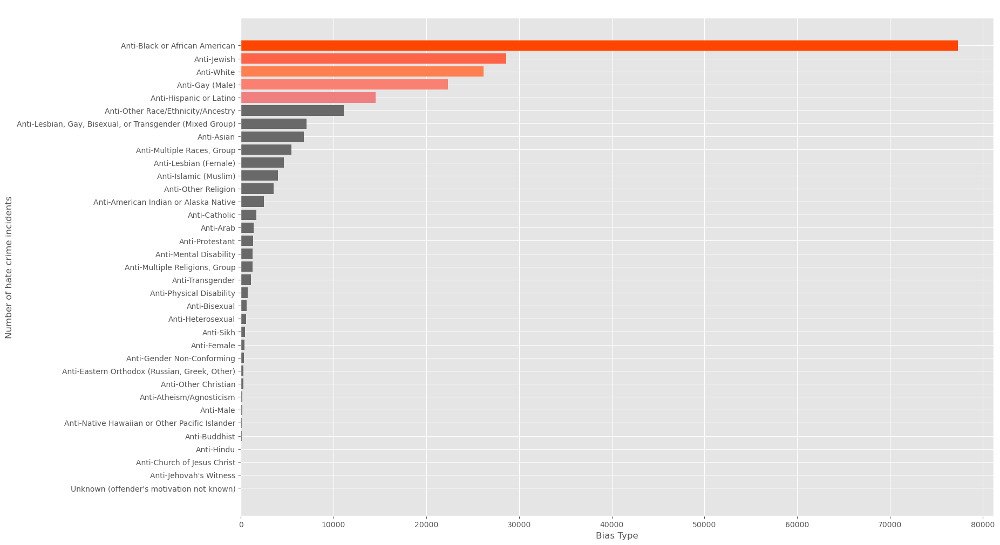

In [27]:
sorted_bias_top = dict(sorted(bias_count.items(), key=lambda x:x[1])[::-1])#[-1:-11:-1])
sorted_bias_low = dict(sorted(bias_count.items(), key=lambda x:x[1])[:10])
plt.style.use('ggplot')
plt.figure(figsize=(18,12))
height = sorted_bias_top.values()
bars = sorted_bias_top.keys()
y_pos = np.arange(len(bars))[::-1]
c = ['orangered','tomato','coral','salmon','lightcoral']#['#002845','#e898ac','#00cfcc','#ff9973','mediumseagreen']
c.extend((len(sorted_bias_top)-5)*['dimgrey'])
# Create horizontal bars
plt.barh(y_pos, height,color = c)
 
# Create names on the x-axis
plt.yticks(y_pos, bars)
plt.title('different bias types\' contribution to hate crimes (from 1991-2021)')
plt.xlabel('Bias Type')
plt.ylabel('Number of hate crime incidents')
# print(sorted_bias_low)
# plt.figure(figsize=(18,6))
# height = sorted_bias_low.values()
# bars = sorted_bias_low.keys()
# y_pos = np.arange(len(bars))
# plt.barh(y_pos, height)
# plt.yticks(y_pos, bars)
# plt.title('5 Least contributing bias types to hate crimes (from 1991-2021)')
# plt.xlabel('Bias Type')
# plt.ylabel('Number of hate crime incidents');


### Word Cloud of Bias types

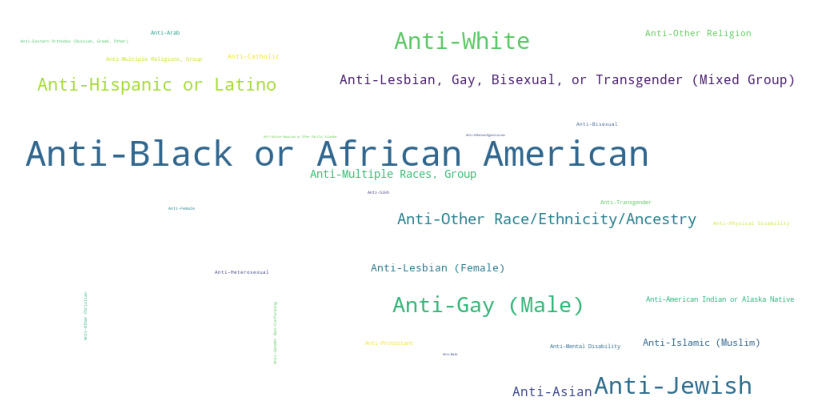

In [20]:
wordcloud = WordCloud(background_color = 'white',width = 1000, height = 500).generate_from_frequencies(bias_count)

plt.figure(figsize=(8,6), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show() 

## Q2) Most frequent Types of victims

In [21]:
victim_count = dict((b,0) for b in victim_types)
for vt in victim_types:
    victim_count[vt] += max(hate_crime['victim_types'].str.contains(vt).sum(), len(hate_crime[hate_crime.victim_types == vt]))

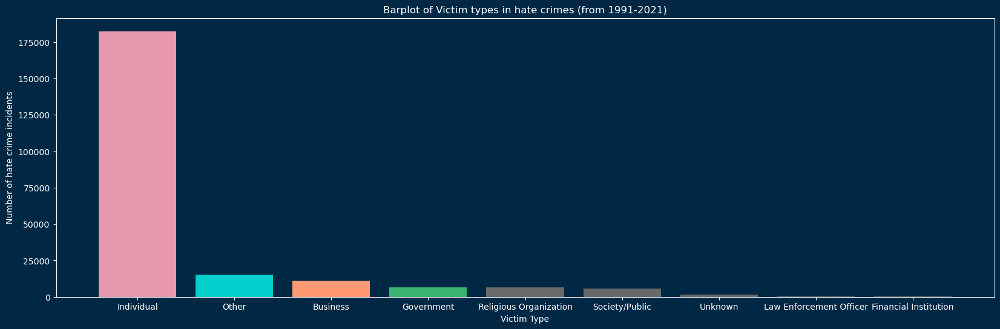

In [21]:
# Create bars
sorted_victim_type = dict(sorted(victim_count.items(), key=lambda x:x[1])[-1::-1])
# plt.style.use('dark_background')
c = ['#e898ac','#00cfcc','#ff9973','mediumseagreen','dimgrey','dimgrey','dimgrey','dimgrey','dimgrey']
fig , ax = plt.subplots(figsize=(20,6))
# ax = plt.axes()
ax.set_facecolor('#002845')
# fig = plt.figure(figsize=(20,6))
fig.patch.set_facecolor('#002845')
ax.bar(sorted_victim_type.keys(), sorted_victim_type.values(),color = c)
ax.set_title('Barplot of Victim types in hate crimes (from 1991-2021)')
ax.set_xlabel('Victim Type')
ax.set_ylabel('Number of hate crime incidents');

### Word Cloud of Victim types

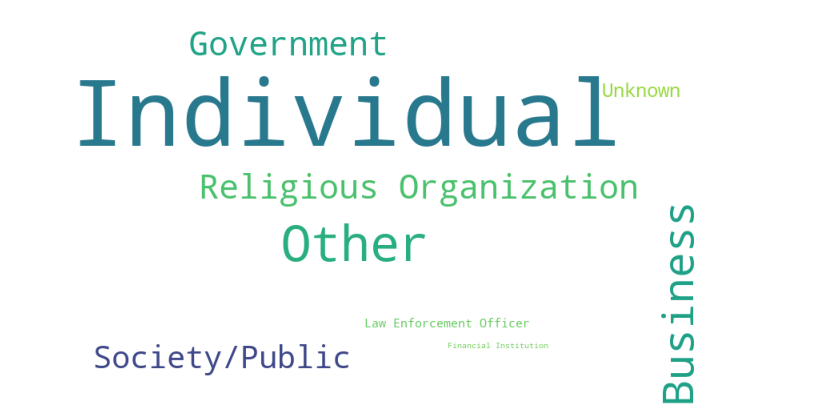

In [22]:
wordcloud = WordCloud(background_color = 'white',width = 1000, height = 500).generate_from_frequencies(victim_count)

plt.figure(figsize=(8,6), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()

In [22]:
victim_df = pd.DataFrame(columns = ['state_name','victim_types','data_year','month'])
for v_type in victim_types:
    rows = hate_crime[hate_crime.victim_types == v_type][['state_name','victim_types' , 'data_year', 'incident_date']]
    rows['month'] = rows['incident_date'].dt.month
    rows.drop(['incident_date'],axis=1,inplace=True)
    if len(rows) > 0:
        victim_df = victim_df.append(rows, ignore_index=True)

In [23]:
victim_df['victim_type_count_per_year'] = victim_df.groupby(['data_year','victim_types'])['month'].transform('count')
victim_df['victim_type_count_per_state_per_year_per_month'] = victim_df.groupby(['data_year','month','victim_types','state_name'])['month'].transform('count')

victim_df = victim_df.drop_duplicates()
victim_df = victim_df.sort_values(by=['data_year','month']).reset_index(drop=True)
victim_df.shape

victim_df['victim_type_per_state_per_year'] = victim_df.groupby(['data_year','victim_types','state_name'])['victim_type_count_per_state_per_year_per_month'].transform('sum')

victim_df['victim_type_per_year_per_month'] = victim_df.groupby(['data_year','victim_types','month'])['victim_type_count_per_state_per_year_per_month'].transform('sum')

## Q3) Investigating the Hate Crime Trend over the years

### Hate Crime Trend over the years

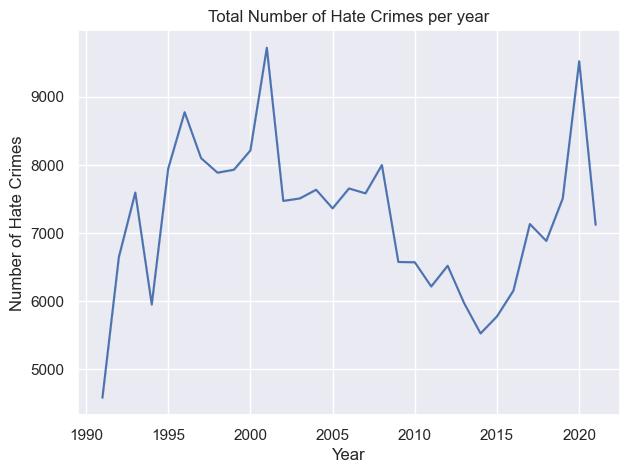

In [27]:
plt.figure(figsize = (7,5))
sns.set_theme(style="darkgrid")
pl = sns.lineplot(hate_crime.data_year, hate_crime.total_hate_crimes_per_year)
pl.set(xlabel ="Year", ylabel = "Number of Hate Crimes", title ='Total Number of Hate Crimes per year');

In [24]:
print(f"The year {hate_crime.loc[hate_crime.total_hate_crimes_per_year.argmax(),'data_year']} has the maximun numer of hate crimes: {hate_crime.total_hate_crimes_per_year.max()} ")
print(f"The year {hate_crime.loc[hate_crime.total_hate_crimes_per_year.argmin(),'data_year']} has the minimum numer of hate crimes: {hate_crime.total_hate_crimes_per_year.min()} ")

The year 2001 has the maximun numer of hate crimes: 9730 
The year 1991 has the minimum numer of hate crimes: 4589 


According to the above figure, we see an almost __increasing__ trend in the number of hate crimes from *1991* to *2001*. after that there is a __decrease__ in the number of hate crimes until *2014*. then, we see another __increasing__ slope from *2014* to *2020*. and there is __dip__ in *2021*.<br>We have highest hate number of hate crimes in *2020*, and the lowest in *1991*.

more figures are plotted in the following sections that show the Hate Crime Trend. this is just a basic one to help us plot more detailed figures.

## Q4) What regions/states are the most significant contributors to hate<br>&emsp;&ensp; crimes?

### Hate Crime Trend per State over the years

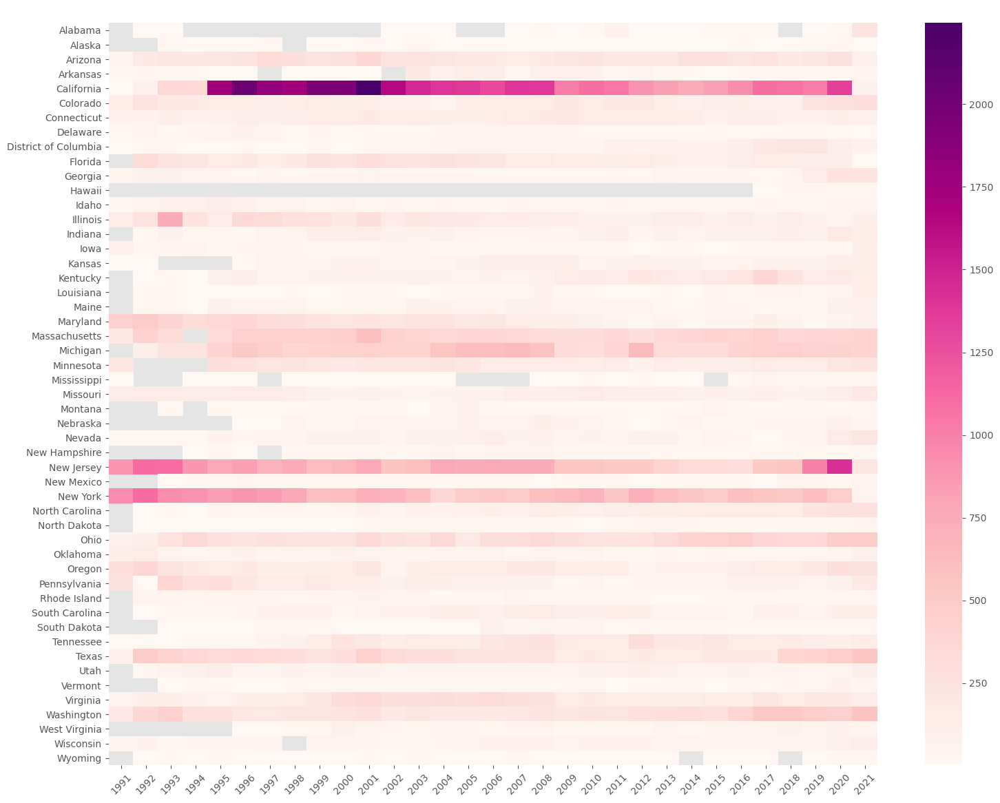

In [28]:
plt.figure(figsize=(18, 14))
df_pivot = hate_crime[['state_name', 'data_year', 'total_hate_crimes_per_state_per_year']].pivot_table(values='total_hate_crimes_per_state_per_year', index='state_name', columns='data_year')
sns.heatmap(df_pivot, fmt='.0f', cmap='RdPu')
plt.xticks(rotation=45)
plt.title('Total number of hate crimes over the years in each State')
plt.xlabel('')
plt.ylabel('')
plt.show()

As we see in the above heatmap, *California* has the highest number of hate crimes per year overal. and after that, *New Jersey* and *New York* are competing for the second place.<br>Keep in mind that these are the reported hate crime records over the years. so in states with fewer Police facilities, there fewer reports of hate crimes (as you see the white sapces in place of some years for some states).

In [29]:
hate_crime['hate_crime_per_state'] = hate_crime[['state_name','incident_id']].groupby('state_name').transform('count')

In [30]:
fig = px.choropleth(
                    locations=hate_crime['state_abbr'], 
                    locationmode="USA-states", 
                    scope="usa",
                    color=hate_crime['hate_crime_per_state'],
                    color_continuous_scale="Viridis_r", 
                    )
fig.update_layout(title="Number of Hate crimes per state Cumulative (1991-2021)",
    width=600,
    height=400)
fig.show()   

In [32]:
fig = px.choropleth(#hate_crime[['hate_crime_per_state','state_abbr']],
                    locations=hate_crime['state_abbr'], 
                    locationmode="USA-states", 
                    scope="usa",
                    animation_frame=hate_crime["data_year"],
                    #color_continuous_scale='Reds',
                    range_color=[0,2000],
                    color=hate_crime['total_hate_crimes_per_state_per_year'],
                    color_continuous_scale="Viridis_r", 
                    

                    )
fig.update_layout(title="Number of Hate crimes per state in each year (United States)",
    width=600,
    height=400)
fig.show()    

## Q5 ) What category of hate crimes are the most recurring ones?

### Hate crime trend over the years per offense type

In [24]:
offense_df = pd.DataFrame(columns = ['state_abbr','state_name','offense_name','data_year','month'])
for off in offense_names:
    rows = hate_crime[hate_crime.offense_name == off][['state_abbr','state_name','offense_name' , 'data_year', 'incident_date']]
    rows['month'] = rows['incident_date'].dt.month
    rows.drop(['incident_date'],axis=1,inplace=True)
    if len(rows) > 0:
        offense_df = offense_df.append(rows, ignore_index=True)

In [25]:
offense_df.head()

,state_abbr,state_name,offense_name,data_year,month
0,AR,Arkansas,Aggravated Assault,1991,7
1,AR,Arkansas,Aggravated Assault,1991,12
2,AR,Arkansas,Aggravated Assault,1991,11
3,AZ,Arizona,Aggravated Assault,1991,2
4,AZ,Arizona,Aggravated Assault,1991,7


In [26]:
offense_df['offense_count_per_state_per_year_per_month'] = offense_df.groupby(['data_year','month','state_name','offense_name'])['month'].transform('count')
offense_df

,state_abbr,state_name,offense_name,data_year,month,offense_count_per_state_per_year_per_month
0,AR,Arkansas,Aggravated Assault,1991,7,1
1,AR,Arkansas,Aggravated Assault,1991,12,1
2,AR,Arkansas,Aggravated Assault,1991,11,1
3,AZ,Arizona,Aggravated Assault,1991,2,1
4,AZ,Arizona,Aggravated Assault,1991,7,1
...,...,...,...,...,...,...
218627,MI,Michigan,Animal Cruelty,2020,8,1
218628,NC,North Carolina,Animal Cruelty,2020,7,1
218629,MS,Mississippi,Gambling Equipment Violation,2020,4,1
218630,FS,Federal,"Human Trafficking, Involuntary Servitude",2021,11,1


In [27]:
offense_df = offense_df.drop_duplicates()
offense_df = offense_df.sort_values(by=['data_year','month']).reset_index(drop=True)
offense_df.shape


(55352, 6)

In [37]:
offense_df['offense_count_per_state_per_year'] = offense_df.groupby(['data_year','offense_name','state_name'])['offense_count_per_state_per_year_per_month'].transform('sum')

In [38]:
offense_df['offense_count_per_year_per_month'] = offense_df.groupby(['data_year','offense_name','month'])['offense_count_per_state_per_year_per_month'].transform('sum')

In [23]:
for y in offense_df.data_year.unique():
    df = offense_df[offense_df.data_year == y].sort_values(by='offense_name')
    l = 9
    w = 4
    if df['offense_name'].nunique() > 19:
        w = 9
    plt.figure(figsize=(l,w))
    df_pivot = df[offense_df.data_year == y][['offense_name', 'month', 'offense_count_per_year_per_month']].pivot_table(values='offense_count_per_year_per_month', index='offense_name', columns='month')
    sns.heatmap(df_pivot, fmt='.0f', cmap='RdPu',vmin=0, vmax=400)
    plt.xticks()
    plt.title(f'Heatmap of offense types per month in {y}')
    plt.xlabel('Month')
    plt.ylabel('Offense Name')
    plt.show()

NameError: name 'offense_df' is not defined

In [40]:
offense_count = dict((b,0) for b in offense_names) 
for off in offense_names:
    offense_count[off] += max(hate_crime['offense_name'].str.contains(off).sum(), len(hate_crime[hate_crime.offense_name == off]))

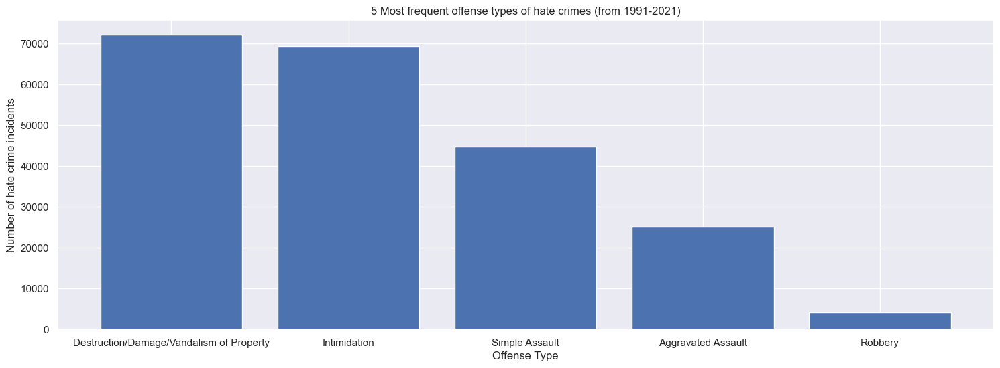

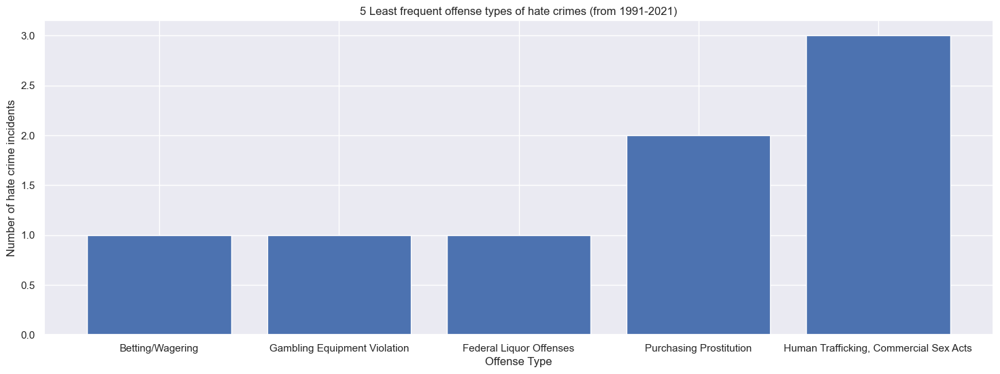

In [41]:
# Create bars
sorted_offense_top = dict(sorted(offense_count.items(), key=lambda x:x[1])[-1:-6:-1])
sorted_offense_low = dict(sorted(offense_count.items(), key=lambda x:x[1])[:5])


plt.figure(figsize=(18,6))
plt.bar(sorted_offense_top.keys(), sorted_offense_top.values())
plt.title('5 Most frequent offense types of hate crimes (from 1991-2021)')
plt.xlabel('Offense Type')
plt.ylabel('Number of hate crime incidents')

plt.figure(figsize=(18,6))
plt.bar(sorted_offense_low.keys(), sorted_offense_low.values())
plt.title('5 Least frequent offense types of hate crimes (from 1991-2021)')
plt.xlabel('Offense Type')
plt.ylabel('Number of hate crime incidents');

In [42]:
for i,off in enumerate(list(sorted_offense_top.keys())):
    df = offense_df[offense_df.offense_name == off]
    fig = px.choropleth(#hate_crime[['hate_crime_per_state','state_abbr']],
                        locations=df['state_abbr'], 
                        locationmode="USA-states", 
                        scope="usa",
                        animation_frame=df["data_year"],
                        #color_continuous_scale='Reds',
                        range_color=[0,400],
                        color=df['offense_count_per_state_per_year'],
                        color_continuous_scale="Viridis_r", 
                        

                        )
    fig.update_layout(title=f"Number of << {off} >> offense per state in each year",
        width=800,
        height=400)
    fig.show()   

FileNotFoundError: [Errno 2] No such file or directory: 'Desktop\\file2.html'